In [1]:
import sys

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

import scanpy as sc
import scvi

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all" # to show output from all the lines in a cells
pd.set_option('display.max_column',None) # display all the columns in pandas
pd.options.display.max_rows = 100

from datetime import date
today = str(date.today())

import matplotlib
from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 150, vector_friendly = True, format = 'pdf')
import scrublet as scr

In [2]:
cd F:\PROJECTS\PROJECT_HUMAN FETAL COCHLEAE\WORKPLACE\R\

F:\PROJECTS\PROJECT_HUMAN FETAL COCHLEAE\WORKPLACE\R


G:\Miniconda3\envs\scvi-env\lib\site-packages\IPython\core\magics\osm.py:417: UserWarning: using dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


In [3]:
sc.logging.print_version_and_date()

Running Scanpy 1.9.8, on 2024-06-19 13:56.


In [5]:
hu_orgn=sc.read('Hu_organoids_python.h5ad')

G:\Miniconda3\envs\scvi-env\lib\site-packages\anndata\__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


In [6]:
hu_orgn

AnnData object with n_obs × n_vars = 21552 × 38224
    obs: 'nCount_RNA', 'nFeature_RNA', 'devtime', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'new_id', 'RNA_snn_res.0.8', 'seurat_clusters', 'subclasses'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable'
    obsm: 'X_harmony', 'X_pca', 'X_umap_harmony'

In [8]:
hu_orgn.obsm['X_umap']=hu_orgn.obsm['X_umap_harmony']

In [9]:
hu_orgn

AnnData object with n_obs × n_vars = 21552 × 38224
    obs: 'nCount_RNA', 'nFeature_RNA', 'devtime', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'new_id', 'RNA_snn_res.0.8', 'seurat_clusters', 'subclasses'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable'
    obsm: 'X_harmony', 'X_pca', 'X_umap_harmony', 'X_umap'

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


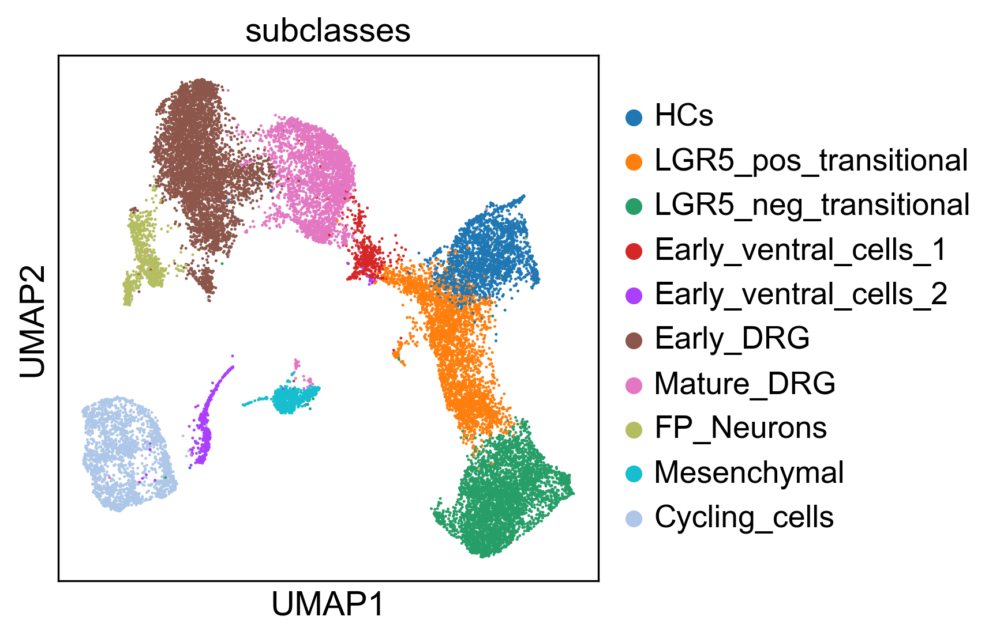

In [10]:
sc.pl.umap(hu_orgn,color="subclasses")# change samples

In [11]:
hu_orgn.obs['subclasses'].value_counts()

Early_DRG                4839
LGR5_neg_transitional    3983
LGR5_pos_transitional    3126
Mature_DRG               2867
HCs                      2161
Cycling_cells            2125
FP_Neurons                863
Mesenchymal               609
Early_ventral_cells_1     496
Early_ventral_cells_2     483
Name: subclasses, dtype: int64

In [14]:
#subset cochlear epithelium domains for downsream analysis
hu_orgn_coe= hu_orgn[hu_orgn.obs['subclasses'].isin(['HCs','LGR5_neg_transitional','LGR5_pos_transitional'])]
hu_orgn_coe
hu_orgn_coe.obs['subclasses'].value_counts()

View of AnnData object with n_obs × n_vars = 9270 × 38224
    obs: 'nCount_RNA', 'nFeature_RNA', 'devtime', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'new_id', 'RNA_snn_res.0.8', 'seurat_clusters', 'subclasses'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable'
    uns: 'subclasses_colors'
    obsm: 'X_harmony', 'X_pca', 'X_umap_harmony', 'X_umap'

LGR5_neg_transitional    3983
LGR5_pos_transitional    3126
HCs                      2161
Name: subclasses, dtype: int64

DATA INTEGRATION

In [15]:
import torch
scvi.settings.seed = 0
print("Last run with scvi-tools version:", scvi.__version__)

Seed set to 0


Last run with scvi-tools version: 1.1.2


In [19]:
hu_orgn_coe.obs['batch']=hu_orgn_coe.obs['devtime']

In [20]:
hu_orgn_coe.obs['batch'].value_counts()

D80     3303
D20     3037
D109    2930
Name: batch, dtype: int64

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


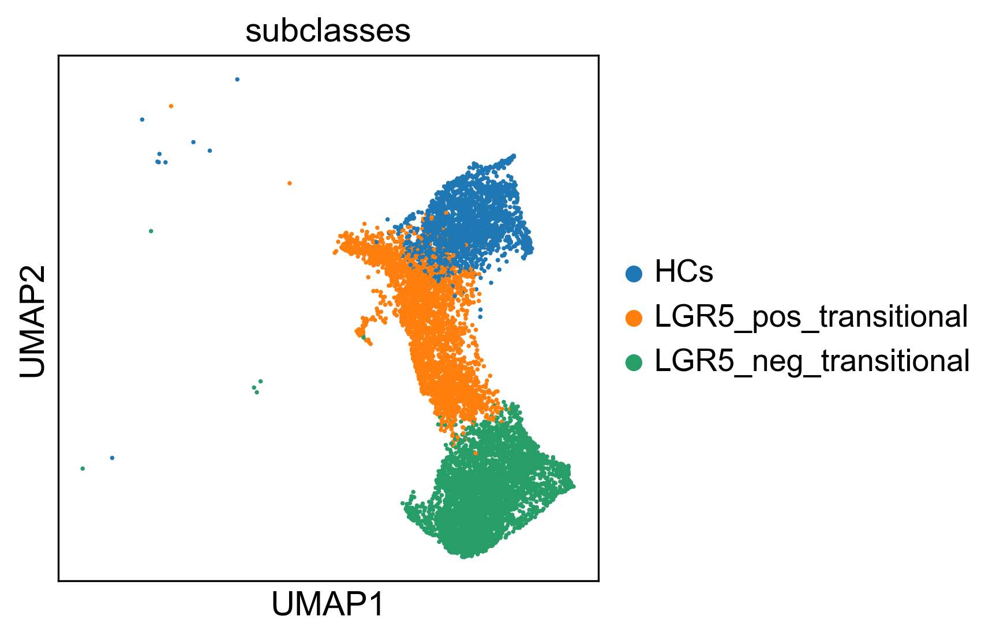

In [21]:
sc.pl.umap(hu_orgn_coe,color="subclasses")# change samples

In [22]:
hu_orgn_coe

AnnData object with n_obs × n_vars = 9270 × 38224
    obs: 'nCount_RNA', 'nFeature_RNA', 'devtime', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'new_id', 'RNA_snn_res.0.8', 'seurat_clusters', 'subclasses', 'batch'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable'
    uns: 'subclasses_colors'
    obsm: 'X_harmony', 'X_pca', 'X_umap_harmony', 'X_umap'

In [23]:
label_key = "subclasses"
batch_key = "batch"

In [24]:
sc.pp.filter_genes(hu_orgn_coe, min_cells=1)
hu_orgn_coe

AnnData object with n_obs × n_vars = 9270 × 29756
    obs: 'nCount_RNA', 'nFeature_RNA', 'devtime', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'new_id', 'RNA_snn_res.0.8', 'seurat_clusters', 'subclasses', 'batch'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable', 'n_cells'
    uns: 'subclasses_colors'
    obsm: 'X_harmony', 'X_pca', 'X_umap_harmony', 'X_umap'

In [25]:
hu_orgn_coe.write("human_organoid_cochlea_epithelium_raw.h5ad")

In [26]:
adata=hu_orgn_coe.copy()
adata

AnnData object with n_obs × n_vars = 9270 × 29756
    obs: 'nCount_RNA', 'nFeature_RNA', 'devtime', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'new_id', 'RNA_snn_res.0.8', 'seurat_clusters', 'subclasses', 'batch'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable', 'n_cells'
    uns: 'subclasses_colors'
    obsm: 'X_harmony', 'X_pca', 'X_umap_harmony', 'X_umap'

In [27]:
adata.X
adata.layers["counts"] = adata.X.copy() 
adata.layers['counts']
adata.X = adata.layers["counts"].copy()
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
#sc.pp.scale(adata)
adata.layers["logcounts"] = adata.X.copy()
adata.layers['logcounts']

<9270x29756 sparse matrix of type '<class 'numpy.float64'>'
	with 38220398 stored elements in Compressed Sparse Column format>

<9270x29756 sparse matrix of type '<class 'numpy.float64'>'
	with 38220398 stored elements in Compressed Sparse Column format>

<9270x29756 sparse matrix of type '<class 'numpy.float64'>'
	with 38220398 stored elements in Compressed Sparse Column format>

In [28]:
sc.pp.highly_variable_genes(adata)
sc.tl.pca(adata)
sc.pp.neighbors(adata)
sc.tl.umap(adata)
adata

AnnData object with n_obs × n_vars = 9270 × 29756
    obs: 'nCount_RNA', 'nFeature_RNA', 'devtime', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'new_id', 'RNA_snn_res.0.8', 'seurat_clusters', 'subclasses', 'batch'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'subclasses_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'umap'
    obsm: 'X_harmony', 'X_pca', 'X_umap_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'logcounts'
    obsp: 'distances', 'connectivities'

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


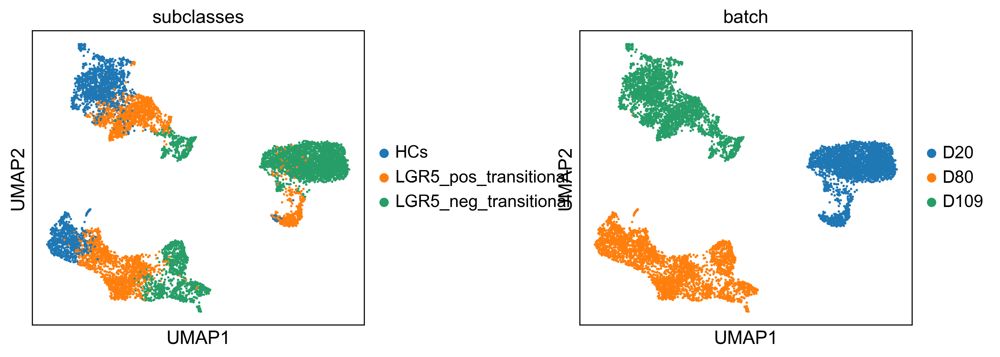

In [29]:
adata.uns[batch_key + "_colors"] = [
    "#1b9e77",
    
    "#7570b3",
]  # Set custom colours for batches
sc.pl.umap(adata, color=[label_key, batch_key], wspace=0.5)

In [30]:
sc.pp.highly_variable_genes(
    adata, n_top_genes=2000, flavor="cell_ranger", batch_key=batch_key
)
adata
adata.var

AnnData object with n_obs × n_vars = 9270 × 29756
    obs: 'nCount_RNA', 'nFeature_RNA', 'devtime', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'new_id', 'RNA_snn_res.0.8', 'seurat_clusters', 'subclasses', 'batch'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'subclasses_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'batch_colors'
    obsm: 'X_harmony', 'X_pca', 'X_umap_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'logcounts'
    obsp: 'distances', 'connectivities'

,vst.mean,vst.variance,vst.variance.expected,vst.variance.standardized,vst.variable,n_cells,highly_variable,means,dispersions,dispersions_norm,highly_variable_nbatches,highly_variable_intersection
MIR1302-2HG,0.000116,0.000116,0.000119,0.976350,False,2,False,0.000239,0.712730,1.136214,0,False
OR4F5,0.000039,0.000039,0.000039,0.999536,False,1,False,0.000133,0.439139,0.850885,1,False
AL627309.1,0.005312,0.005284,0.006409,0.824530,False,48,False,0.004132,0.808008,-1.415474,0,False
AL627309.3,0.000349,0.000349,0.000369,0.945776,False,2,False,0.000170,0.544732,-0.134124,0,False
AL627309.4,0.000155,0.000155,0.000160,0.969659,False,1,False,0.000090,0.295672,0.039569,0,False
...,...,...,...,...,...,...,...,...,...,...,...,...
AF274853.1,0.005661,0.006172,0.006850,0.900985,False,47,False,0.004297,0.276452,-0.047661,0,False
U52112.1,0.000271,0.000271,0.000284,0.954653,False,4,False,0.000297,0.219093,-0.510562,0,False
AC244090.3,0.005118,0.005325,0.006163,0.863994,False,75,False,0.006715,0.269251,-0.182878,0,False
AC011751.1,0.000039,0.000039,0.000039,0.999536,False,1,False,0.000076,0.221613,-0.167216,0,False


In [31]:
n_batches = adata.var["highly_variable_nbatches"].value_counts()
n_batches

0    25264
1     3315
2      846
3      331
Name: highly_variable_nbatches, dtype: int64

In [32]:
adata_hvg = adata[:, adata.var["highly_variable"]].copy()
adata_hvg

AnnData object with n_obs × n_vars = 9270 × 2000
    obs: 'nCount_RNA', 'nFeature_RNA', 'devtime', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'new_id', 'RNA_snn_res.0.8', 'seurat_clusters', 'subclasses', 'batch'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'subclasses_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'batch_colors'
    obsm: 'X_harmony', 'X_pca', 'X_umap_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'logcounts'
    obsp: 'distances', 'connectivities'

In [33]:
adata_scvi = adata_hvg.copy()
scvi.model.SCVI.setup_anndata(adata_scvi, layer="counts", batch_key=batch_key)
adata_scvi

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\data\fields\_base_field.py:64: UserWarning: adata.layers[counts] does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\data\fields\_layer_field.py:115: UserWarning: Training will be faster when sparse matrix is formatted as CSR. It is safe to cast before model initialization.
  _verify_and_correct_data_format(adata, self.attr_name, self.attr_key)


AnnData object with n_obs × n_vars = 9270 × 2000
    obs: 'nCount_RNA', 'nFeature_RNA', 'devtime', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'new_id', 'RNA_snn_res.0.8', 'seurat_clusters', 'subclasses', 'batch', '_scvi_batch', '_scvi_labels'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'subclasses_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'batch_colors', '_scvi_uuid', '_scvi_manager_uuid'
    obsm: 'X_harmony', 'X_pca', 'X_umap_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'logcounts'
    obsp: 'distances', 'connectivities'

In [34]:
model_scvi = scvi.model.SCVI(adata_scvi)
model_scvi

SCVI model with the following parameters: 
n_hidden: 128, n_latent: 10, n_layers: 1, dropout_rate: 0.1, dispersion: gene, gene_likelihood: zinb, 
latent_distribution: normal.
Training status: Not Trained
Model's adata is minified?: False

In [35]:
model_scvi.view_anndata_setup()

Anndata setup with scvi-tools version 1.1.2.

Setup via `SCVI.setup_anndata` with arguments:

{
│   'layer': 'counts',
│   'batch_key': 'batch',
│   'labels_key': None,
│   'size_factor_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   3   │
│         n_cells          │ 9270  │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
│         n_labels         │   1   │
│          n_vars          │ 2000  │
└──────────────────────────┴───────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │  adata.layers['counts']   │
│    batch     │ adata.obs['_scvi_batch']  │
│    labels    │ adata.obs['_scvi_labels'] │
└──────────────┴───────────────────────────┘

                  batch State Registry                   
┏━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃  Source Location   ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['batch'] │    D20     │          0          │
│                    │    D80     │          1          │
│                    │    D109    │          2          │
└────────────────────┴────────────┴─────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

In [36]:
max_epochs_scvi = np.min([round((20000 / adata.n_obs) * 400), 400])
max_epochs_scvi

400

In [37]:
model_scvi.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
G:\Miniconda3\envs\scvi-env\lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=47` in the `DataLoader` to improve performance.


Epoch 1/400:   0%|                       | 0/400 [00:00<?, ?it/s]

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 2/400:   0%| | 1/400 [00:02<14:52,  2.24s/it, v_num=1, trai

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 3/400:   0%| | 2/400 [00:04<13:35,  2.05s/it, v_num=1, trai

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 4/400:   1%| | 3/400 [00:06<13:10,  1.99s/it, v_num=1, trai

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 5/400:   1%| | 4/400 [00:08<13:02,  1.98s/it, v_num=1, trai

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 6/400:   1%| | 5/400 [00:10<12:57,  1.97s/it, v_num=1, trai

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 7/400:   2%| | 6/400 [00:11<12:55,  1.97s/it, v_num=1, trai

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 8/400:   2%| | 7/400 [00:13<12:51,  1.96s/it, v_num=1, trai

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 9/400:   2%| | 8/400 [00:15<12:43,  1.95s/it, v_num=1, trai

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 10/400:   2%| | 9/400 [00:17<12:41,  1.95s/it, v_num=1, tra

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 11/400:   2%| | 10/400 [00:19<12:38,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 12/400:   3%| | 11/400 [00:21<12:34,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 13/400:   3%| | 12/400 [00:23<12:31,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 14/400:   3%| | 13/400 [00:25<12:29,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 15/400:   4%| | 14/400 [00:27<12:28,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 16/400:   4%| | 15/400 [00:29<12:26,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 17/400:   4%| | 16/400 [00:31<12:25,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 18/400:   4%| | 17/400 [00:33<12:20,  1.93s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 19/400:   4%| | 18/400 [00:35<12:16,  1.93s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 20/400:   5%| | 19/400 [00:37<12:15,  1.93s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 21/400:   5%| | 20/400 [00:39<12:16,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 22/400:   5%| | 21/400 [00:41<12:24,  1.96s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 23/400:   6%| | 22/400 [00:43<12:16,  1.95s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 24/400:   6%| | 23/400 [00:44<12:12,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 25/400:   6%| | 24/400 [00:46<12:20,  1.97s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 26/400:   6%| | 25/400 [00:48<12:15,  1.96s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 27/400:   6%| | 26/400 [00:50<12:13,  1.96s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 28/400:   7%| | 27/400 [00:52<12:05,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 29/400:   7%| | 28/400 [00:54<12:04,  1.95s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 30/400:   7%| | 29/400 [00:56<11:58,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 31/400:   8%| | 30/400 [00:58<11:57,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 32/400:   8%| | 31/400 [01:00<11:53,  1.93s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 33/400:   8%| | 32/400 [01:02<11:52,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 34/400:   8%| | 33/400 [01:04<11:48,  1.93s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 35/400:   8%| | 34/400 [01:06<11:45,  1.93s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 36/400:   9%| | 35/400 [01:08<11:48,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 37/400:   9%| | 36/400 [01:10<11:44,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 38/400:   9%| | 37/400 [01:12<11:45,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 39/400:  10%| | 38/400 [01:14<11:39,  1.93s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 40/400:  10%| | 39/400 [01:16<11:55,  1.98s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 41/400:  10%| | 40/400 [01:18<11:56,  1.99s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 42/400:  10%| | 41/400 [01:20<11:57,  2.00s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 43/400:  10%| | 42/400 [01:22<12:00,  2.01s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 44/400:  11%| | 43/400 [01:24<11:49,  1.99s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 45/400:  11%| | 44/400 [01:26<11:38,  1.96s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 46/400:  11%| | 45/400 [01:28<11:43,  1.98s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 47/400:  12%| | 46/400 [01:30<11:41,  1.98s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 48/400:  12%| | 47/400 [01:31<11:34,  1.97s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 49/400:  12%| | 48/400 [01:33<11:28,  1.95s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 50/400:  12%| | 49/400 [01:35<11:27,  1.96s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 51/400:  12%|▏| 50/400 [01:37<11:29,  1.97s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 52/400:  13%|▏| 51/400 [01:39<11:23,  1.96s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 53/400:  13%|▏| 52/400 [01:41<11:16,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 54/400:  13%|▏| 53/400 [01:43<11:13,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 55/400:  14%|▏| 54/400 [01:45<11:09,  1.93s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 56/400:  14%|▏| 55/400 [01:47<11:10,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 57/400:  14%|▏| 56/400 [01:49<11:17,  1.97s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 58/400:  14%|▏| 57/400 [01:51<11:14,  1.97s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 59/400:  14%|▏| 58/400 [01:53<11:07,  1.95s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 60/400:  15%|▏| 59/400 [01:55<11:00,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 61/400:  15%|▏| 60/400 [01:57<10:57,  1.93s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 62/400:  15%|▏| 61/400 [01:59<10:57,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 63/400:  16%|▏| 62/400 [02:01<10:55,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 64/400:  16%|▏| 63/400 [02:03<10:58,  1.95s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 65/400:  16%|▏| 64/400 [02:05<10:57,  1.96s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 66/400:  16%|▏| 65/400 [02:07<10:50,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 67/400:  16%|▏| 66/400 [02:08<10:48,  1.94s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 68/400:  17%|▏| 67/400 [02:10<10:42,  1.93s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 69/400:  17%|▏| 68/400 [02:12<10:39,  1.93s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 70/400:  17%|▏| 69/400 [02:14<10:36,  1.92s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 71/400:  18%|▏| 70/400 [02:16<10:33,  1.92s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 72/400:  18%|▏| 71/400 [02:18<10:34,  1.93s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 73/400:  18%|▏| 72/400 [02:20<10:39,  1.95s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 74/400:  18%|▏| 73/400 [02:22<10:42,  1.97s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 75/400:  18%|▏| 74/400 [02:24<10:45,  1.98s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 76/400:  19%|▏| 75/400 [02:26<10:48,  2.00s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 77/400:  19%|▏| 76/400 [02:28<10:55,  2.02s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 78/400:  19%|▏| 77/400 [02:30<10:45,  2.00s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 79/400:  20%|▏| 78/400 [02:32<10:36,  1.98s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 80/400:  20%|▏| 79/400 [02:34<10:30,  1.96s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 81/400:  20%|▏| 80/400 [02:36<10:33,  1.98s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 82/400:  20%|▏| 81/400 [02:38<10:27,  1.97s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 83/400:  20%|▏| 82/400 [02:40<10:28,  1.98s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 84/400:  21%|▏| 83/400 [02:42<10:27,  1.98s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 85/400:  21%|▏| 84/400 [02:44<10:22,  1.97s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 86/400:  21%|▏| 85/400 [02:46<10:25,  1.99s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 87/400:  22%|▏| 86/400 [02:48<10:23,  1.99s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 88/400:  22%|▏| 87/400 [02:50<10:33,  2.02s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 89/400:  22%|▏| 88/400 [02:52<10:23,  2.00s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 90/400:  22%|▏| 89/400 [02:54<10:17,  1.99s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 91/400:  22%|▏| 90/400 [02:56<10:12,  1.97s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 92/400:  23%|▏| 91/400 [02:58<10:12,  1.98s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 93/400:  23%|▏| 92/400 [03:00<10:07,  1.97s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 94/400:  23%|▏| 93/400 [03:02<10:03,  1.97s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 95/400:  24%|▏| 94/400 [03:04<10:01,  1.96s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 96/400:  24%|▏| 95/400 [03:06<10:00,  1.97s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 97/400:  24%|▏| 96/400 [03:08<10:01,  1.98s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 98/400:  24%|▏| 97/400 [03:10<09:56,  1.97s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 99/400:  24%|▏| 98/400 [03:12<09:52,  1.96s/it, v_num=1, tr

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 100/400:  25%|▏| 99/400 [03:14<09:59,  1.99s/it, v_num=1, t

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 101/400:  25%|▎| 100/400 [03:16<09:56,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 102/400:  25%|▎| 101/400 [03:18<09:54,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 103/400:  26%|▎| 102/400 [03:20<09:53,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 104/400:  26%|▎| 103/400 [03:22<09:52,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 105/400:  26%|▎| 104/400 [03:24<09:48,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 106/400:  26%|▎| 105/400 [03:26<09:46,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 107/400:  26%|▎| 106/400 [03:28<09:43,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 108/400:  27%|▎| 107/400 [03:29<09:38,  1.98s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 109/400:  27%|▎| 108/400 [03:31<09:35,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 110/400:  27%|▎| 109/400 [03:33<09:29,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 111/400:  28%|▎| 110/400 [03:35<09:30,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 112/400:  28%|▎| 111/400 [03:37<09:31,  1.98s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 113/400:  28%|▎| 112/400 [03:39<09:27,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 114/400:  28%|▎| 113/400 [03:41<09:24,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 115/400:  28%|▎| 114/400 [03:43<09:22,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 116/400:  29%|▎| 115/400 [03:45<09:21,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 117/400:  29%|▎| 116/400 [03:47<09:16,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 118/400:  29%|▎| 117/400 [03:49<09:21,  1.98s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 119/400:  30%|▎| 118/400 [03:51<09:16,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 120/400:  30%|▎| 119/400 [03:53<09:12,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 121/400:  30%|▎| 120/400 [03:55<09:11,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 122/400:  30%|▎| 121/400 [03:57<09:14,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 123/400:  30%|▎| 122/400 [03:59<09:11,  1.98s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 124/400:  31%|▎| 123/400 [04:01<09:10,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 125/400:  31%|▎| 124/400 [04:03<09:06,  1.98s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 126/400:  31%|▎| 125/400 [04:05<09:02,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 127/400:  32%|▎| 126/400 [04:07<09:05,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 128/400:  32%|▎| 127/400 [04:09<09:40,  2.13s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 129/400:  32%|▎| 128/400 [04:12<09:46,  2.15s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 130/400:  32%|▎| 129/400 [04:14<09:54,  2.20s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 131/400:  32%|▎| 130/400 [04:16<09:41,  2.15s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 132/400:  33%|▎| 131/400 [04:18<09:38,  2.15s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 133/400:  33%|▎| 132/400 [04:20<09:17,  2.08s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 134/400:  33%|▎| 133/400 [04:22<09:03,  2.04s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 135/400:  34%|▎| 134/400 [04:24<08:52,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 136/400:  34%|▎| 135/400 [04:26<08:45,  1.98s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 137/400:  34%|▎| 136/400 [04:28<08:39,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 138/400:  34%|▎| 137/400 [04:30<08:36,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 139/400:  34%|▎| 138/400 [04:32<08:31,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 140/400:  35%|▎| 139/400 [04:34<08:28,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 141/400:  35%|▎| 140/400 [04:36<08:28,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 142/400:  35%|▎| 141/400 [04:38<08:24,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 143/400:  36%|▎| 142/400 [04:39<08:22,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 144/400:  36%|▎| 143/400 [04:41<08:20,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 145/400:  36%|▎| 144/400 [04:43<08:21,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 146/400:  36%|▎| 145/400 [04:45<08:16,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 147/400:  36%|▎| 146/400 [04:47<08:16,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 148/400:  37%|▎| 147/400 [04:49<08:16,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 149/400:  37%|▎| 148/400 [04:51<08:13,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 150/400:  37%|▎| 149/400 [04:53<08:09,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 151/400:  38%|▍| 150/400 [04:55<08:05,  1.94s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 152/400:  38%|▍| 151/400 [04:57<08:05,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 153/400:  38%|▍| 152/400 [04:59<08:04,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 154/400:  38%|▍| 153/400 [05:01<08:00,  1.94s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 155/400:  38%|▍| 154/400 [05:03<07:58,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 156/400:  39%|▍| 155/400 [05:05<08:00,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 157/400:  39%|▍| 156/400 [05:07<08:31,  2.09s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 158/400:  39%|▍| 157/400 [05:09<08:23,  2.07s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 159/400:  40%|▍| 158/400 [05:11<08:13,  2.04s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 160/400:  40%|▍| 159/400 [05:13<08:08,  2.03s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 161/400:  40%|▍| 160/400 [05:16<08:23,  2.10s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 162/400:  40%|▍| 161/400 [05:18<08:25,  2.11s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 163/400:  40%|▍| 162/400 [05:20<08:20,  2.10s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 164/400:  41%|▍| 163/400 [05:22<08:20,  2.11s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 165/400:  41%|▍| 164/400 [05:24<08:09,  2.07s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 166/400:  41%|▍| 165/400 [05:26<08:09,  2.08s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 167/400:  42%|▍| 166/400 [05:28<07:57,  2.04s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 168/400:  42%|▍| 167/400 [05:30<07:50,  2.02s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 169/400:  42%|▍| 168/400 [05:32<07:49,  2.02s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 170/400:  42%|▍| 169/400 [05:34<07:46,  2.02s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 171/400:  42%|▍| 170/400 [05:36<07:46,  2.03s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 172/400:  43%|▍| 171/400 [05:38<07:43,  2.02s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 173/400:  43%|▍| 172/400 [05:40<07:36,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 174/400:  43%|▍| 173/400 [05:42<07:34,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 175/400:  44%|▍| 174/400 [05:44<07:28,  1.98s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 176/400:  44%|▍| 175/400 [05:46<07:27,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 177/400:  44%|▍| 176/400 [05:48<07:21,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 178/400:  44%|▍| 177/400 [05:50<07:19,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 179/400:  44%|▍| 178/400 [05:52<07:14,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 180/400:  45%|▍| 179/400 [05:54<07:13,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 181/400:  45%|▍| 180/400 [05:56<07:31,  2.05s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 182/400:  45%|▍| 181/400 [05:58<07:26,  2.04s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 183/400:  46%|▍| 182/400 [06:00<07:20,  2.02s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 184/400:  46%|▍| 183/400 [06:02<07:15,  2.01s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 185/400:  46%|▍| 184/400 [06:04<07:10,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 186/400:  46%|▍| 185/400 [06:06<07:06,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 187/400:  46%|▍| 186/400 [06:08<07:00,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 188/400:  47%|▍| 187/400 [06:10<06:56,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 189/400:  47%|▍| 188/400 [06:12<06:53,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 190/400:  47%|▍| 189/400 [06:14<06:51,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 191/400:  48%|▍| 190/400 [06:16<06:53,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 192/400:  48%|▍| 191/400 [06:18<06:49,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 193/400:  48%|▍| 192/400 [06:19<06:45,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 194/400:  48%|▍| 193/400 [06:21<06:41,  1.94s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 195/400:  48%|▍| 194/400 [06:23<06:39,  1.94s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 196/400:  49%|▍| 195/400 [06:25<06:36,  1.93s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 197/400:  49%|▍| 196/400 [06:27<06:35,  1.94s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 198/400:  49%|▍| 197/400 [06:29<06:40,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 199/400:  50%|▍| 198/400 [06:31<06:42,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 200/400:  50%|▍| 199/400 [06:33<06:39,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 201/400:  50%|▌| 200/400 [06:35<06:44,  2.02s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 202/400:  50%|▌| 201/400 [06:37<06:46,  2.04s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 203/400:  50%|▌| 202/400 [06:40<06:55,  2.10s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 204/400:  51%|▌| 203/400 [06:42<06:47,  2.07s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 205/400:  51%|▌| 204/400 [06:44<06:40,  2.04s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 206/400:  51%|▌| 205/400 [06:46<06:36,  2.03s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 207/400:  52%|▌| 206/400 [06:48<06:32,  2.02s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 208/400:  52%|▌| 207/400 [06:50<06:41,  2.08s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 209/400:  52%|▌| 208/400 [06:52<06:36,  2.06s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 210/400:  52%|▌| 209/400 [06:54<06:34,  2.07s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 211/400:  52%|▌| 210/400 [06:56<06:31,  2.06s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 212/400:  53%|▌| 211/400 [06:58<06:23,  2.03s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 213/400:  53%|▌| 212/400 [07:00<06:17,  2.01s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 214/400:  53%|▌| 213/400 [07:02<06:13,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 215/400:  54%|▌| 214/400 [07:04<06:06,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 216/400:  54%|▌| 215/400 [07:06<06:01,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 217/400:  54%|▌| 216/400 [07:08<06:01,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 218/400:  54%|▌| 217/400 [07:10<06:01,  1.98s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 219/400:  55%|▌| 218/400 [07:12<05:57,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 220/400:  55%|▌| 219/400 [07:14<05:54,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 221/400:  55%|▌| 220/400 [07:16<05:52,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 222/400:  55%|▌| 221/400 [07:18<05:56,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 223/400:  56%|▌| 222/400 [07:20<05:58,  2.01s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 224/400:  56%|▌| 223/400 [07:22<06:02,  2.05s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 225/400:  56%|▌| 224/400 [07:24<06:06,  2.08s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 226/400:  56%|▌| 225/400 [07:26<06:04,  2.08s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 227/400:  56%|▌| 226/400 [07:28<06:00,  2.07s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 228/400:  57%|▌| 227/400 [07:30<05:53,  2.04s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 229/400:  57%|▌| 228/400 [07:32<05:44,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 230/400:  57%|▌| 229/400 [07:34<05:37,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 231/400:  57%|▌| 230/400 [07:36<05:34,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 232/400:  58%|▌| 231/400 [07:38<05:29,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 233/400:  58%|▌| 232/400 [07:40<05:26,  1.94s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 234/400:  58%|▌| 233/400 [07:42<05:24,  1.94s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 235/400:  58%|▌| 234/400 [07:44<05:20,  1.93s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 236/400:  59%|▌| 235/400 [07:45<05:19,  1.93s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 237/400:  59%|▌| 236/400 [07:47<05:15,  1.93s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 238/400:  59%|▌| 237/400 [07:49<05:13,  1.92s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 239/400:  60%|▌| 238/400 [07:51<05:17,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 240/400:  60%|▌| 239/400 [07:53<05:14,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 241/400:  60%|▌| 240/400 [07:55<05:14,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 242/400:  60%|▌| 241/400 [07:57<05:11,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 243/400:  60%|▌| 242/400 [07:59<05:08,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 244/400:  61%|▌| 243/400 [08:01<05:09,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 245/400:  61%|▌| 244/400 [08:03<05:05,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 246/400:  61%|▌| 245/400 [08:05<05:07,  1.98s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 247/400:  62%|▌| 246/400 [08:07<05:17,  2.06s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 248/400:  62%|▌| 247/400 [08:10<05:19,  2.09s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 249/400:  62%|▌| 248/400 [08:12<05:14,  2.07s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 250/400:  62%|▌| 249/400 [08:14<05:06,  2.03s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 251/400:  62%|▋| 250/400 [08:16<05:06,  2.04s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 252/400:  63%|▋| 251/400 [08:18<05:03,  2.03s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 253/400:  63%|▋| 252/400 [08:20<05:01,  2.04s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 254/400:  63%|▋| 253/400 [08:22<05:01,  2.05s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 255/400:  64%|▋| 254/400 [08:24<05:00,  2.06s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 256/400:  64%|▋| 255/400 [08:26<04:55,  2.04s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 257/400:  64%|▋| 256/400 [08:28<04:53,  2.04s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 258/400:  64%|▋| 257/400 [08:30<04:51,  2.04s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 259/400:  64%|▋| 258/400 [08:32<04:50,  2.05s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 260/400:  65%|▋| 259/400 [08:34<04:50,  2.06s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 261/400:  65%|▋| 260/400 [08:36<04:44,  2.03s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 262/400:  65%|▋| 261/400 [08:38<04:37,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 263/400:  66%|▋| 262/400 [08:40<04:32,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 264/400:  66%|▋| 263/400 [08:42<04:27,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 265/400:  66%|▋| 264/400 [08:44<04:23,  1.94s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 266/400:  66%|▋| 265/400 [08:46<04:25,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 267/400:  66%|▋| 266/400 [08:48<04:23,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 268/400:  67%|▋| 267/400 [08:50<04:26,  2.01s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 269/400:  67%|▋| 268/400 [08:52<04:30,  2.05s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 270/400:  67%|▋| 269/400 [08:54<04:26,  2.03s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 271/400:  68%|▋| 270/400 [08:56<04:20,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 272/400:  68%|▋| 271/400 [08:58<04:17,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 273/400:  68%|▋| 272/400 [09:00<04:17,  2.02s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 274/400:  68%|▋| 273/400 [09:02<04:16,  2.02s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 275/400:  68%|▋| 274/400 [09:04<04:12,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 276/400:  69%|▋| 275/400 [09:06<04:07,  1.98s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 277/400:  69%|▋| 276/400 [09:08<04:04,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 278/400:  69%|▋| 277/400 [09:10<04:02,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 279/400:  70%|▋| 278/400 [09:12<04:01,  1.98s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 280/400:  70%|▋| 279/400 [09:14<03:56,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 281/400:  70%|▋| 280/400 [09:16<03:53,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 282/400:  70%|▋| 281/400 [09:18<03:52,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 283/400:  70%|▋| 282/400 [09:19<03:51,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 284/400:  71%|▋| 283/400 [09:22<04:01,  2.06s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 285/400:  71%|▋| 284/400 [09:24<04:06,  2.12s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 286/400:  71%|▋| 285/400 [09:26<04:05,  2.13s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 287/400:  72%|▋| 286/400 [09:28<03:58,  2.09s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 288/400:  72%|▋| 287/400 [09:30<03:53,  2.07s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 289/400:  72%|▋| 288/400 [09:32<03:46,  2.03s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 290/400:  72%|▋| 289/400 [09:34<03:42,  2.01s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 291/400:  72%|▋| 290/400 [09:36<03:53,  2.12s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 292/400:  73%|▋| 291/400 [09:38<03:46,  2.08s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 293/400:  73%|▋| 292/400 [09:40<03:41,  2.05s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 294/400:  73%|▋| 293/400 [09:42<03:35,  2.01s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 295/400:  74%|▋| 294/400 [09:44<03:32,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 296/400:  74%|▋| 295/400 [09:46<03:30,  2.01s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 297/400:  74%|▋| 296/400 [09:48<03:28,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 298/400:  74%|▋| 297/400 [09:50<03:28,  2.03s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 299/400:  74%|▋| 298/400 [09:52<03:27,  2.03s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 300/400:  75%|▋| 299/400 [09:55<03:26,  2.04s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 301/400:  75%|▊| 300/400 [09:57<03:21,  2.02s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 302/400:  75%|▊| 301/400 [09:58<03:16,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 303/400:  76%|▊| 302/400 [10:00<03:15,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 304/400:  76%|▊| 303/400 [10:02<03:12,  1.98s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 305/400:  76%|▊| 304/400 [10:04<03:10,  1.98s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 306/400:  76%|▊| 305/400 [10:06<03:10,  2.01s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 307/400:  76%|▊| 306/400 [10:08<03:08,  2.01s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 308/400:  77%|▊| 307/400 [10:10<03:06,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 309/400:  77%|▊| 308/400 [10:12<03:02,  1.98s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 310/400:  77%|▊| 309/400 [10:14<03:01,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 311/400:  78%|▊| 310/400 [10:16<03:00,  2.01s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 312/400:  78%|▊| 311/400 [10:18<02:57,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 313/400:  78%|▊| 312/400 [10:20<02:55,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 314/400:  78%|▊| 313/400 [10:22<02:54,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 315/400:  78%|▊| 314/400 [10:24<02:51,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 316/400:  79%|▊| 315/400 [10:26<02:47,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 317/400:  79%|▊| 316/400 [10:28<02:44,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 318/400:  79%|▊| 317/400 [10:30<02:41,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 319/400:  80%|▊| 318/400 [10:32<02:38,  1.94s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 320/400:  80%|▊| 319/400 [10:34<02:36,  1.93s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 321/400:  80%|▊| 320/400 [10:36<02:34,  1.93s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 322/400:  80%|▊| 321/400 [10:38<02:35,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 323/400:  80%|▊| 322/400 [10:40<02:35,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 324/400:  81%|▊| 323/400 [10:42<02:35,  2.02s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 325/400:  81%|▊| 324/400 [10:44<02:31,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 326/400:  81%|▊| 325/400 [10:46<02:27,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 327/400:  82%|▊| 326/400 [10:48<02:25,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 328/400:  82%|▊| 327/400 [10:50<02:27,  2.02s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 329/400:  82%|▊| 328/400 [10:52<02:27,  2.04s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 330/400:  82%|▊| 329/400 [10:54<02:22,  2.01s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 331/400:  82%|▊| 330/400 [10:56<02:24,  2.07s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 332/400:  83%|▊| 331/400 [10:58<02:21,  2.06s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 333/400:  83%|▊| 332/400 [11:00<02:16,  2.01s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 334/400:  83%|▊| 333/400 [11:02<02:13,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 335/400:  84%|▊| 334/400 [11:04<02:09,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 336/400:  84%|▊| 335/400 [11:06<02:07,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 337/400:  84%|▊| 336/400 [11:08<02:07,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 338/400:  84%|▊| 337/400 [11:10<02:05,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 339/400:  84%|▊| 338/400 [11:12<02:04,  2.01s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 340/400:  85%|▊| 339/400 [11:14<02:07,  2.09s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 341/400:  85%|▊| 340/400 [11:16<02:03,  2.05s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 342/400:  85%|▊| 341/400 [11:18<01:58,  2.01s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 343/400:  86%|▊| 342/400 [11:20<01:56,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 344/400:  86%|▊| 343/400 [11:22<01:53,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 345/400:  86%|▊| 344/400 [11:24<01:50,  1.98s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 346/400:  86%|▊| 345/400 [11:26<01:54,  2.07s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 347/400:  86%|▊| 346/400 [11:28<01:49,  2.02s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 348/400:  87%|▊| 347/400 [11:30<01:45,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 349/400:  87%|▊| 348/400 [11:32<01:42,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 350/400:  87%|▊| 349/400 [11:34<01:40,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 351/400:  88%|▉| 350/400 [11:36<01:39,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 352/400:  88%|▉| 351/400 [11:38<01:36,  1.98s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 353/400:  88%|▉| 352/400 [11:40<01:34,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 354/400:  88%|▉| 353/400 [11:42<01:31,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 355/400:  88%|▉| 354/400 [11:44<01:31,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 356/400:  89%|▉| 355/400 [11:46<01:29,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 357/400:  89%|▉| 356/400 [11:48<01:26,  1.97s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 358/400:  89%|▉| 357/400 [11:50<01:23,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 359/400:  90%|▉| 358/400 [11:52<01:21,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 360/400:  90%|▉| 359/400 [11:54<01:19,  1.94s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 361/400:  90%|▉| 360/400 [11:56<01:18,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 362/400:  90%|▉| 361/400 [11:58<01:16,  1.96s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 363/400:  90%|▉| 362/400 [12:00<01:13,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 364/400:  91%|▉| 363/400 [12:02<01:11,  1.93s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 365/400:  91%|▉| 364/400 [12:03<01:09,  1.92s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 366/400:  91%|▉| 365/400 [12:05<01:08,  1.95s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 367/400:  92%|▉| 366/400 [12:07<01:05,  1.93s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 368/400:  92%|▉| 367/400 [12:09<01:03,  1.93s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 369/400:  92%|▉| 368/400 [12:11<01:01,  1.92s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 370/400:  92%|▉| 369/400 [12:13<00:59,  1.91s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 371/400:  92%|▉| 370/400 [12:15<00:57,  1.91s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 372/400:  93%|▉| 371/400 [12:17<00:57,  1.98s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 373/400:  93%|▉| 372/400 [12:19<00:58,  2.07s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 374/400:  93%|▉| 373/400 [12:21<00:54,  2.03s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 375/400:  94%|▉| 374/400 [12:23<00:52,  2.03s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 376/400:  94%|▉| 375/400 [12:25<00:50,  2.03s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 377/400:  94%|▉| 376/400 [12:27<00:48,  2.01s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 378/400:  94%|▉| 377/400 [12:29<00:45,  1.99s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 379/400:  94%|▉| 378/400 [12:31<00:43,  1.98s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 380/400:  95%|▉| 379/400 [12:33<00:41,  1.98s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 381/400:  95%|▉| 380/400 [12:35<00:40,  2.02s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 382/400:  95%|▉| 381/400 [12:37<00:37,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 383/400:  96%|▉| 382/400 [12:39<00:36,  2.02s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 384/400:  96%|▉| 383/400 [12:42<00:34,  2.05s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 385/400:  96%|▉| 384/400 [12:44<00:32,  2.06s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 386/400:  96%|▉| 385/400 [12:46<00:30,  2.04s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 387/400:  96%|▉| 386/400 [12:48<00:28,  2.04s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 388/400:  97%|▉| 387/400 [12:50<00:26,  2.03s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 389/400:  97%|▉| 388/400 [12:52<00:25,  2.12s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 390/400:  97%|▉| 389/400 [12:54<00:23,  2.11s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 391/400:  98%|▉| 390/400 [12:56<00:20,  2.07s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 392/400:  98%|▉| 391/400 [12:58<00:18,  2.04s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 393/400:  98%|▉| 392/400 [13:00<00:16,  2.01s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 394/400:  98%|▉| 393/400 [13:02<00:14,  2.01s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 395/400:  98%|▉| 394/400 [13:04<00:12,  2.01s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 396/400:  99%|▉| 395/400 [13:06<00:09,  2.00s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 397/400:  99%|▉| 396/400 [13:08<00:08,  2.02s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 398/400:  99%|▉| 397/400 [13:10<00:06,  2.03s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 399/400: 100%|▉| 398/400 [13:12<00:04,  2.03s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 400/400: 100%|▉| 399/400 [13:14<00:02,  2.03s/it, v_num=1, 

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_vae.py:458: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -generative_outputs["px"].log_prob(x).sum(-1)


Epoch 400/400: 100%|█| 400/400 [13:16<00:00,  2.01s/it, v_num=1, 

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|█| 400/400 [13:16<00:00,  1.99s/it, v_num=1, 


In [38]:
adata_scvi.obsm["X_scVI"] = model_scvi.get_latent_representation()

AnnData object with n_obs × n_vars = 9270 × 2000
    obs: 'nCount_RNA', 'nFeature_RNA', 'devtime', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'new_id', 'RNA_snn_res.0.8', 'seurat_clusters', 'subclasses', 'batch', '_scvi_batch', '_scvi_labels'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'subclasses_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'batch_colors', '_scvi_uuid', '_scvi_manager_uuid'
    obsm: 'X_harmony', 'X_pca', 'X_umap_harmony', 'X_umap', 'X_scVI'
    varm: 'PCs'
    layers: 'counts', 'logcounts'
    obsp: 'distances', 'connectivities'

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


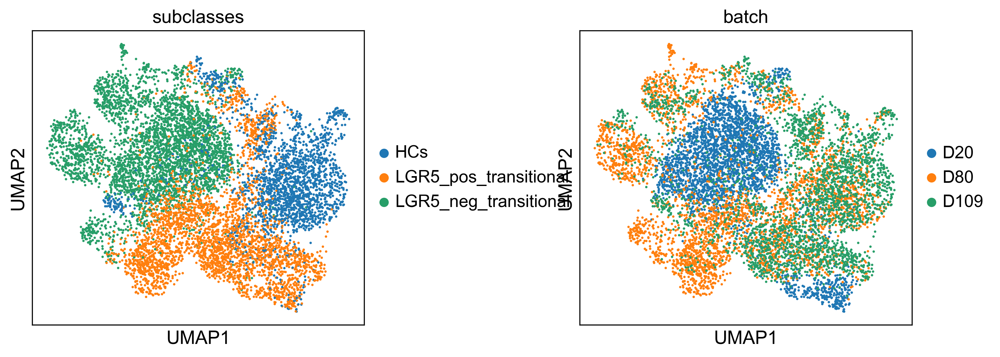

In [45]:
sc.pp.neighbors(adata_scvi, use_rep="X_scVI",n_neighbors=50)#,n_neighbors=90
sc.tl.umap(adata_scvi,min_dist=0.6)
adata_scvi
sc.pl.umap(adata_scvi, color=[label_key, batch_key], wspace=0.5)

In [46]:
# Normally we would need to run scVI first but we have already done that here
# model_scvi = scvi.model.SCVI(adata_scvi) etc.
model_scanvi = scvi.model.SCANVI.from_scvi_model(
    model_scvi, labels_key=label_key, unlabeled_category="unlabelled"
)#unlabelled
print(model_scanvi)
model_scanvi.view_anndata_setup()

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\data\fields\_base_field.py:64: UserWarning: adata.layers[counts] does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\data\fields\_layer_field.py:115: UserWarning: Training will be faster when sparse matrix is formatted as CSR. It is safe to cast before model initialization.
  _verify_and_correct_data_format(adata, self.attr_name, self.attr_key)


ScanVI Model with the following params: 
unlabeled_category: unlabelled, n_hidden: 128, n_latent: 10, n_layers: 1, dropout_rate: 0.1, dispersion: gene, 
gene_likelihood: zinb
Training status: Not Trained
Model's adata is minified?: False

Anndata setup with scvi-tools version 1.1.2.

Setup via `SCANVI.setup_anndata` with arguments:

{
│   'labels_key': 'subclasses',
│   'unlabeled_category': 'unlabelled',
│   'layer': 'counts',
│   'batch_key': 'batch',
│   'size_factor_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   3   │
│         n_cells          │ 9270  │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
│         n_labels         │   4   │
│          n_vars          │ 2000  │
└──────────────────────────┴───────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │  adata.layers['counts']   │
│    batch     │ adata.obs['_scvi_batch']  │
│    labels    │ adata.obs['_scvi_labels'] │
└──────────────┴───────────────────────────┘

                  batch State Registry                   
┏━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃  Source Location   ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['batch'] │    D20     │          0          │
│                    │    D80     │          1          │
│                    │    D109    │          2          │
└────────────────────┴────────────┴─────────────────────┘

                          labels State Registry                          
┏━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃     Source Location     ┃      Categories       ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['subclasses'] │          HCs          │          0          │
│                         │ LGR5_pos_transitional │          1          │
│                         │ LGR5_neg_transitional │          2          │
│                         │      unlabelled       │          3          │
└─────────────────────────┴───────────────────────┴─────────────────────┘

In [47]:
max_epochs_scanvi = int(np.min([10, np.max([2, round(max_epochs_scvi / 3.0)])]))
model_scanvi.train(max_epochs=max_epochs_scanvi)

INFO     Training for 10 epochs.                                                                                   


GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
G:\Miniconda3\envs\scvi-env\lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=47` in the `DataLoader` to improve performance.


Epoch 1/10:   0%|                         | 0/10 [00:00<?, ?it/s]

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 2/10:  10%| | 1/10 [00:03<00:33,  3.78s/it, v_num=1, train_

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 3/10:  20%|▏| 2/10 [00:07<00:29,  3.72s/it, v_num=1, train_

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 4/10:  30%|▎| 3/10 [00:10<00:25,  3.63s/it, v_num=1, train_

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 5/10:  40%|▍| 4/10 [00:14<00:21,  3.54s/it, v_num=1, train_

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 6/10:  50%|▌| 5/10 [00:17<00:17,  3.49s/it, v_num=1, train_

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 7/10:  60%|▌| 6/10 [00:21<00:14,  3.54s/it, v_num=1, train_

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 8/10:  70%|▋| 7/10 [00:24<00:10,  3.52s/it, v_num=1, train_

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 9/10:  80%|▊| 8/10 [00:28<00:07,  3.62s/it, v_num=1, train_

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 10/10:  90%|▉| 9/10 [00:32<00:03,  3.62s/it, v_num=1, train

G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)
G:\Miniconda3\envs\scvi-env\lib\site-packages\scvi\module\_scanvae.py:304: UserWarning: The value argument must be within the support of the distribution
  reconst_loss = -px.log_prob(x).sum(-1)


Epoch 10/10: 100%|█| 10/10 [00:35<00:00,  3.58s/it, v_num=1, trai

`Trainer.fit` stopped: `max_epochs=10` reached.


Epoch 10/10: 100%|█| 10/10 [00:35<00:00,  3.59s/it, v_num=1, trai


G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


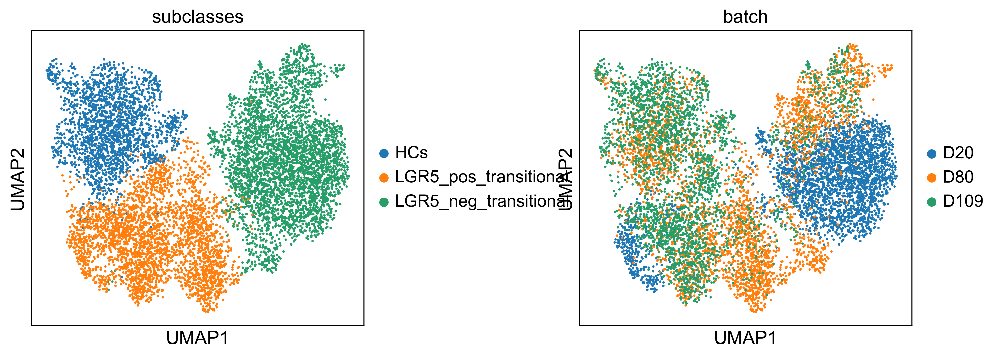

In [79]:
adata_scanvi = adata_scvi.copy()
adata_scanvi.obsm["X_scANVI"] = model_scanvi.get_latent_representation()
sc.pp.neighbors(adata_scanvi, use_rep="X_scANVI",n_neighbors=60)#n_neighbors=50
sc.tl.umap(adata_scanvi,min_dist=0.8)#0.4
sc.pl.umap(adata_scanvi, color=[label_key, batch_key], wspace=0.5)

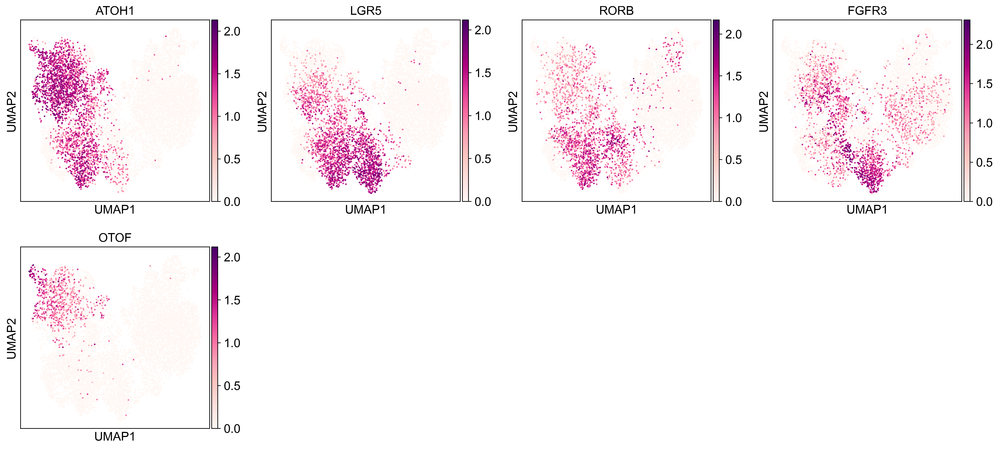

In [80]:
sc.settings.set_figure_params(dpi=200)
sc.pl.umap(adata_scanvi, color = ['ATOH1','LGR5','RORB','FGFR3','OTOF',
                                 ], legend_loc = "on data", legend_fontsize = 5)

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


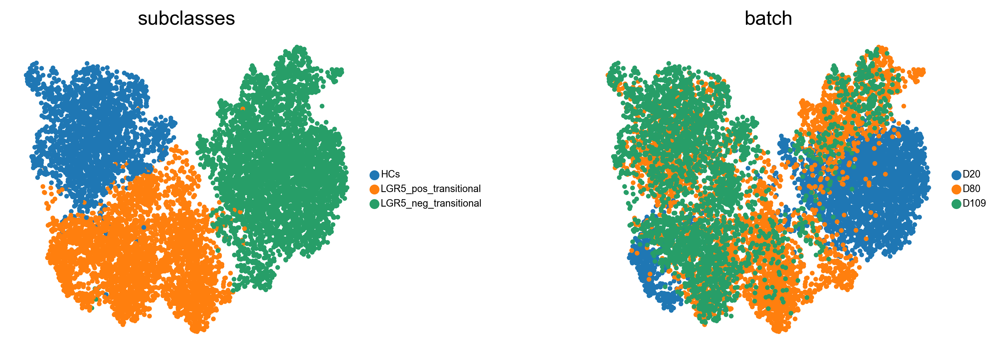

In [122]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(adata_scanvi, color=[label_key, batch_key], wspace=0.5,frameon=False, legend_fontsize=7, legend_fontoutline=False,
           size=45,
          save="human_organoid_coe_scanvi_subclasses.pdf")

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


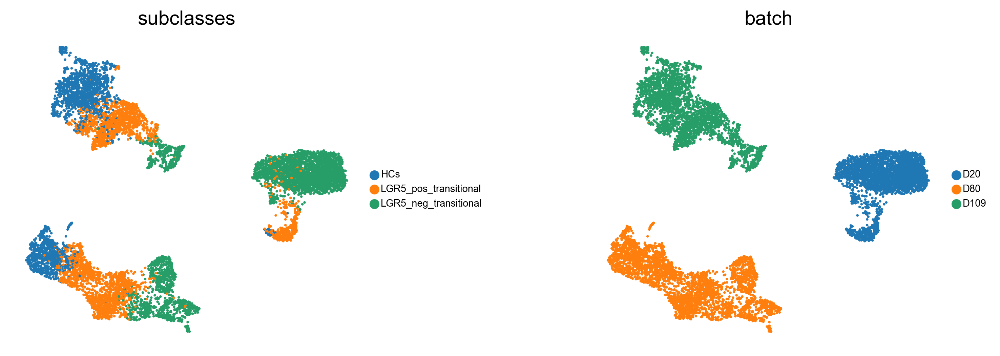

In [82]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(adata, color=[label_key, batch_key], wspace=0.5,frameon=False, legend_fontsize=7, legend_fontoutline=False,
          save="human_organoid_coe_unintegrated_subclasses.pdf")

In [89]:
sc.tl.leiden(adata_scanvi,resolution=2,key_added='cluster1')

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


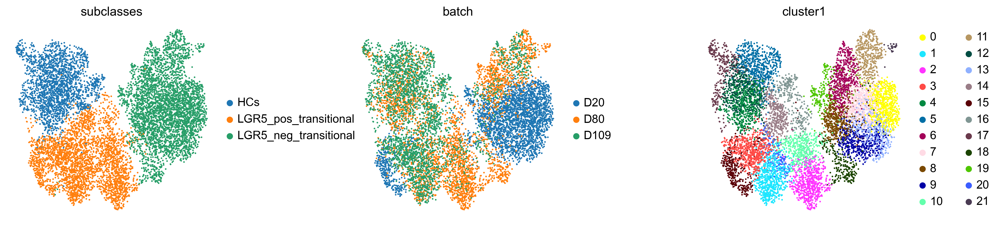

In [90]:
sc.pl.umap(adata_scanvi, color=[label_key, batch_key,'cluster1'], wspace=0.5)

In [91]:
pd.DataFrame(adata_scanvi.obsm["X_scANVI"]).to_csv('HUMAN_organoid_COE_scANVI.csv')

In [92]:
X_scANVI = pd.read_csv('HUMAN_organoid_COE_scANVI.csv', index_col=0)
X_scANVI

,0,1,2,3,4,5,6,7,8,9
0,-0.880783,1.097183,0.946857,-0.665756,-0.847983,-0.599450,0.558848,0.637140,-0.922084,0.001926
1,1.616334,1.141176,0.060932,1.031455,0.402663,-1.403390,-0.093370,-0.049230,-0.329213,-1.254936
2,-0.462744,1.619860,-1.194658,-1.084586,-1.071197,-0.812335,0.103745,-0.157730,-2.479739,1.782519
3,-1.274498,0.116563,0.091709,-0.968182,-1.137330,0.263286,-0.749782,-0.034441,-0.212660,-0.033109
4,0.260869,1.806362,0.860512,-0.643345,-1.124144,-0.518304,-1.765304,-1.464603,-0.343614,-0.168280
...,...,...,...,...,...,...,...,...,...,...
9265,1.536857,0.421495,2.496250,1.928382,-0.979480,0.033125,0.282513,-0.448624,0.042931,-0.681934
9266,1.458838,-0.215259,1.019771,0.750357,-0.221110,-0.373200,0.554453,0.002624,2.123072,-0.122499
9267,-2.402649,1.829172,0.462972,1.382420,-0.847393,0.365005,-0.415596,-0.308946,-2.385712,0.140711
9268,3.101277,0.233325,0.081050,-0.296720,-3.067589,-0.869421,0.171906,-0.518493,1.160133,-1.006186


In [93]:
adata.obsm["X_scANVI"] = X_scANVI.to_numpy()

In [94]:
adata

AnnData object with n_obs × n_vars = 9270 × 29756
    obs: 'nCount_RNA', 'nFeature_RNA', 'devtime', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'new_id', 'RNA_snn_res.0.8', 'seurat_clusters', 'subclasses', 'batch'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'subclasses_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'batch_colors'
    obsm: 'X_harmony', 'X_pca', 'X_umap_harmony', 'X_umap', 'X_scANVI'
    varm: 'PCs'
    layers: 'counts', 'logcounts'
    obsp: 'distances', 'connectivities'

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


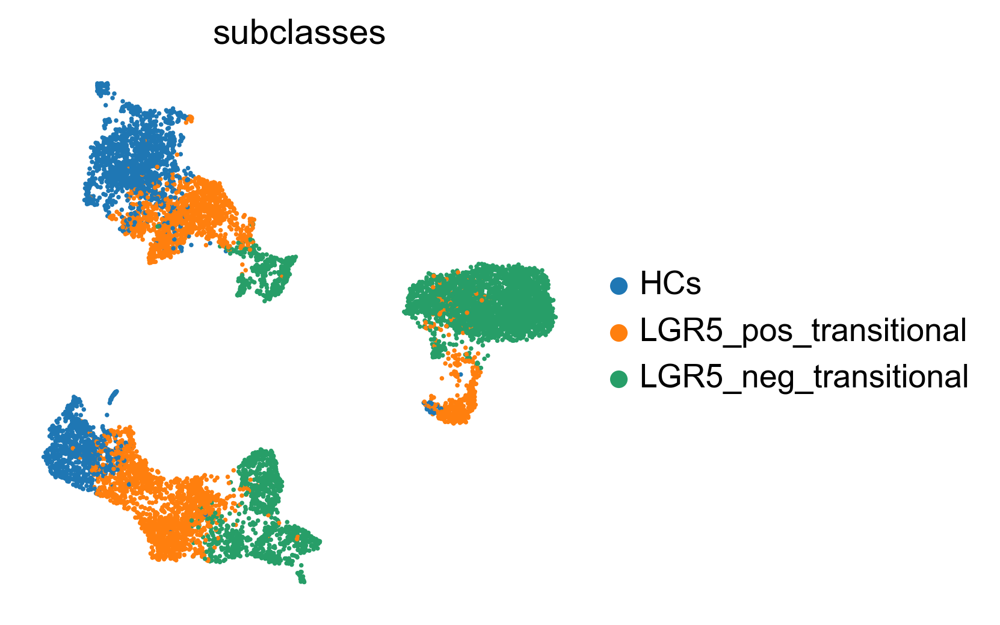

In [95]:
sc.pl.umap(adata, color=['subclasses'], wspace=0.5)

In [96]:
adata_raw_scvi=adata.copy()

In [99]:
sc.pp.neighbors(adata_raw_scvi,use_rep="X_scANVI",n_neighbors=60)
sc.tl.umap(adata_raw_scvi,min_dist=0.8)
sc.tl.leiden(adata_raw_scvi,resolution=2,key_added='cluster1')

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


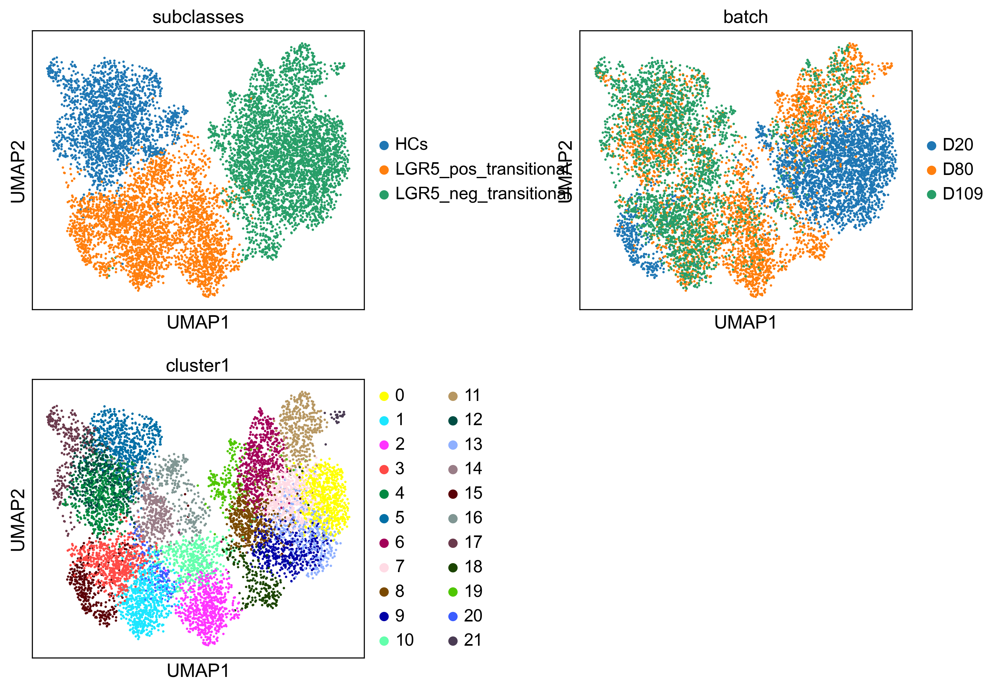

In [100]:
sc.pl.umap(
    adata_raw_scvi,
    color=['subclasses', "batch",'cluster1'], 
    frameon=True,  ncols = 2,wspace = 0.5
)#ncols = 1,

BBKNN INTEGRATION

In [104]:
#An important parameter for BBKNN is the number of neighbors per batch. A suggested heuristic for this is to use 25 if there are more than 100,000 cells or the default of 3 if there are fewer than 100,000
import bbknn
neighbors_within_batch = 25 if adata_hvg.n_obs > 100000 else 3
neighbors_within_batch

3

In [105]:
adata_bbknn = adata_hvg.copy()
adata_bbknn.X = adata_bbknn.layers["logcounts"].copy()
sc.pp.pca(adata_bbknn)

In [106]:
bbknn.bbknn(
    adata_bbknn, batch_key=batch_key, neighbors_within_batch=neighbors_within_batch
)
adata_bbknn

AnnData object with n_obs × n_vars = 9270 × 2000
    obs: 'nCount_RNA', 'nFeature_RNA', 'devtime', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'new_id', 'RNA_snn_res.0.8', 'seurat_clusters', 'subclasses', 'batch'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'subclasses_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'batch_colors'
    obsm: 'X_harmony', 'X_pca', 'X_umap_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'logcounts'
    obsp: 'distances', 'connectivities'

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


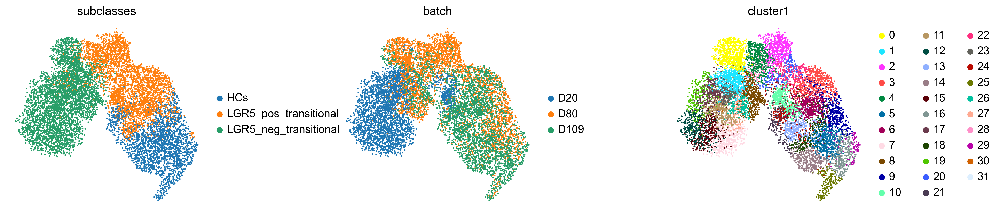

In [107]:
sc.tl.umap(adata_bbknn,min_dist=0.8)
sc.tl.leiden(adata_bbknn,resolution=2,key_added='cluster1')
sc.pl.umap(adata_bbknn, color=[label_key, batch_key,'cluster1'], wspace=0.5)

In [108]:
import scanpy.external as sce

In [109]:
adata_harmony = adata_hvg.copy()

In [110]:
sce.pp.harmony_integrate(adata_harmony, 'batch')

2024-06-19 15:09:25,357 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-06-19 15:09:28,642 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-06-19 15:09:28,780 - harmonypy - INFO - Iteration 1 of 10
2024-06-19 15:09:31,798 - harmonypy - INFO - Iteration 2 of 10
2024-06-19 15:09:34,440 - harmonypy - INFO - Converged after 2 iterations


In [111]:
adata_harmony

AnnData object with n_obs × n_vars = 9270 × 2000
    obs: 'nCount_RNA', 'nFeature_RNA', 'devtime', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'new_id', 'RNA_snn_res.0.8', 'seurat_clusters', 'subclasses', 'batch'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'subclasses_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'batch_colors'
    obsm: 'X_harmony', 'X_pca', 'X_umap_harmony', 'X_umap', 'X_pca_harmony'
    varm: 'PCs'
    layers: 'counts', 'logcounts'
    obsp: 'distances', 'connectivities'

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


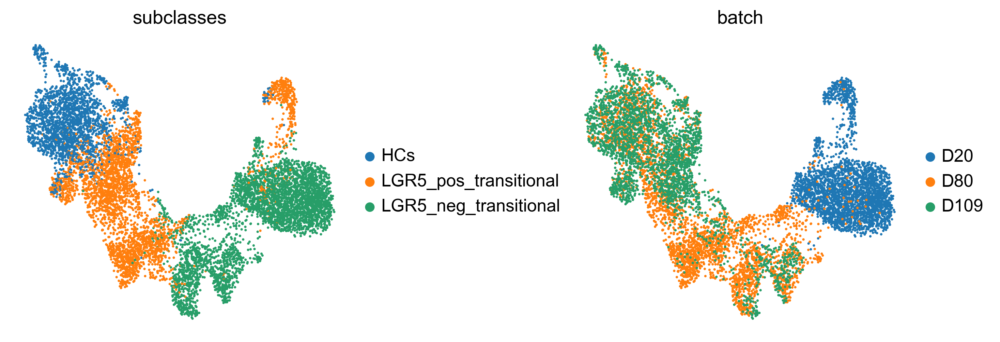

In [113]:
sc.pp.neighbors(adata_harmony, use_rep="X_pca_harmony",n_neighbors=30)
sc.tl.umap(adata_harmony,min_dist=0.6)
sc.pl.umap(adata_harmony, color=[label_key, batch_key], wspace=0.5)

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


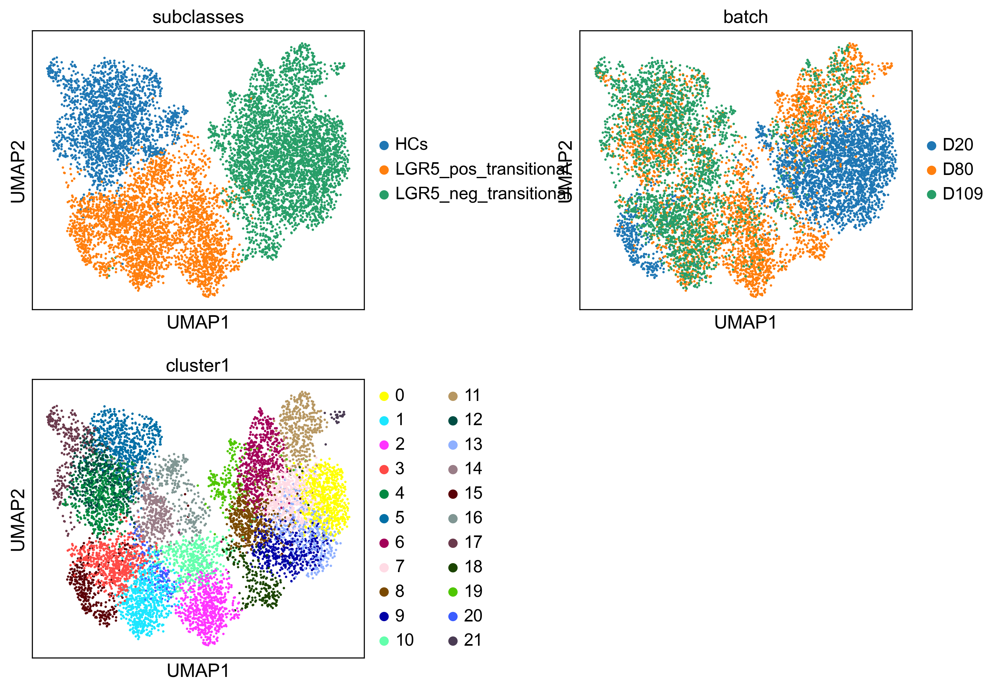

In [114]:
sc.pl.umap(
    adata_raw_scvi,
    color=['subclasses', "batch",'cluster1'], 
    frameon=True,  ncols = 2,wspace = 0.5
)#ncols = 1,

In [115]:
adata_raw_scvi

AnnData object with n_obs × n_vars = 9270 × 29756
    obs: 'nCount_RNA', 'nFeature_RNA', 'devtime', 'percent.mt', 'nCount_SCT', 'nFeature_SCT', 'new_id', 'RNA_snn_res.0.8', 'seurat_clusters', 'subclasses', 'batch', 'cluster1'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'subclasses_colors', 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'batch_colors', 'leiden', 'cluster1_colors'
    obsm: 'X_harmony', 'X_pca', 'X_umap_harmony', 'X_umap', 'X_scANVI'
    varm: 'PCs'
    layers: 'counts', 'logcounts'
    obsp: 'distances', 'connectivities'

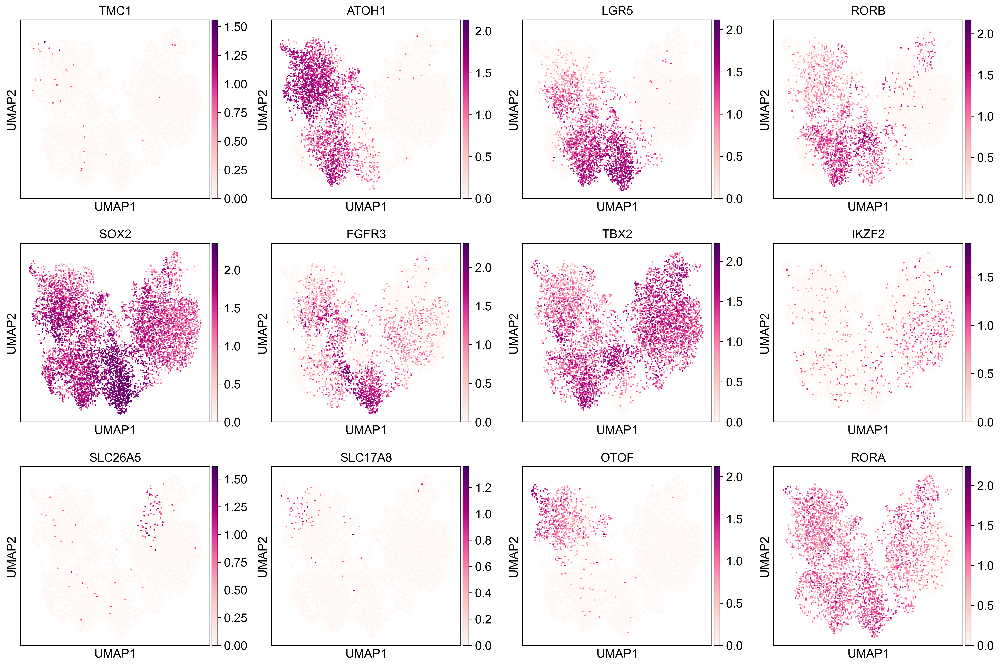

In [118]:
sc.settings.set_figure_params(dpi=200)
sc.pl.umap(adata_raw_scvi, color = ['TMC1','ATOH1','LGR5','RORB','SOX2','FGFR3','TBX2','IKZF2','SLC26A5','SLC17A8','OTOF',
                                 'RORA'], legend_loc = "on data", legend_fontsize = 5)

In [119]:
adata_raw_scvi.write("human_organoid_cochlea_epithelium_scanvi.h5ad")

In [183]:
import torch
sc.set_figure_params(figsize=(6, 6), frameon=False)
sns.set_theme()
torch.set_float32_matmul_precision("high")
#save_dir = tempfile.TemporaryDirectory()

%config InlineBackend.print_figure_kwargs={"facecolor": "w"}
%config InlineBackend.figure_format="retina"

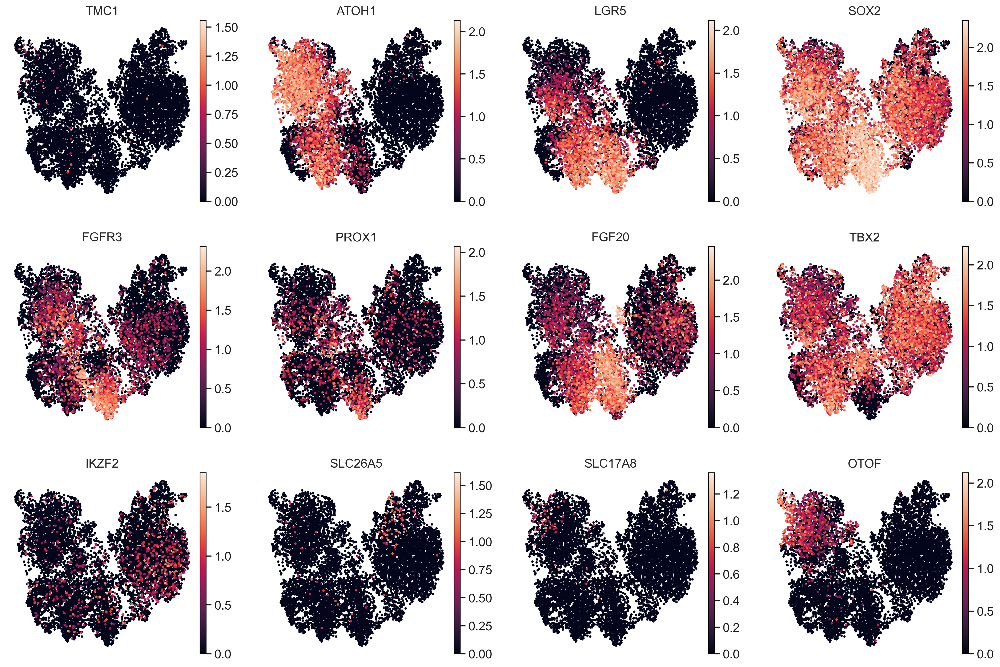

In [185]:
sc.set_figure_params(figsize=(4,4),frameon=False,dpi=150,dpi_save=600)
sc.pl.umap(adata_raw_scvi, color = ['TMC1','ATOH1','LGR5','SOX2','FGFR3', 'PROX1','FGF20',   'TBX2','IKZF2','SLC26A5','SLC17A8','OTOF',],
           legend_loc = "on data", legend_fontsize = 5,size=30,
          save="human_organoid_coe_scanvi_subclasses_markers.pdf")

In [123]:
import scFates as scf

In [171]:
scf.tl.tree(adata_raw_scvi,Nodes=15,use_rep="X_umap",method="ppt",seed=1,ppt_lambda=50,ppt_sigma=.8,ppt_nsteps=5)

inferring a principal tree --> parameters used 
    15 principal points, sigma = 0.8, lambda = 50, metric = euclidean
    fitting: 100%|████████████████| 5/5 [00:00<00:00, 184.39it/s]
    not converged (error: 0.1469847392152339)
    finished (0:00:00) --> added 
    .uns['ppt'], dictionnary containing inferred tree.
    .obsm['X_R'] soft assignment of cells to principal points.
    .uns['graph']['B'] adjacency matrix of the principal points.
    .uns['graph']['F'] coordinates of principal points in representation space.


G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


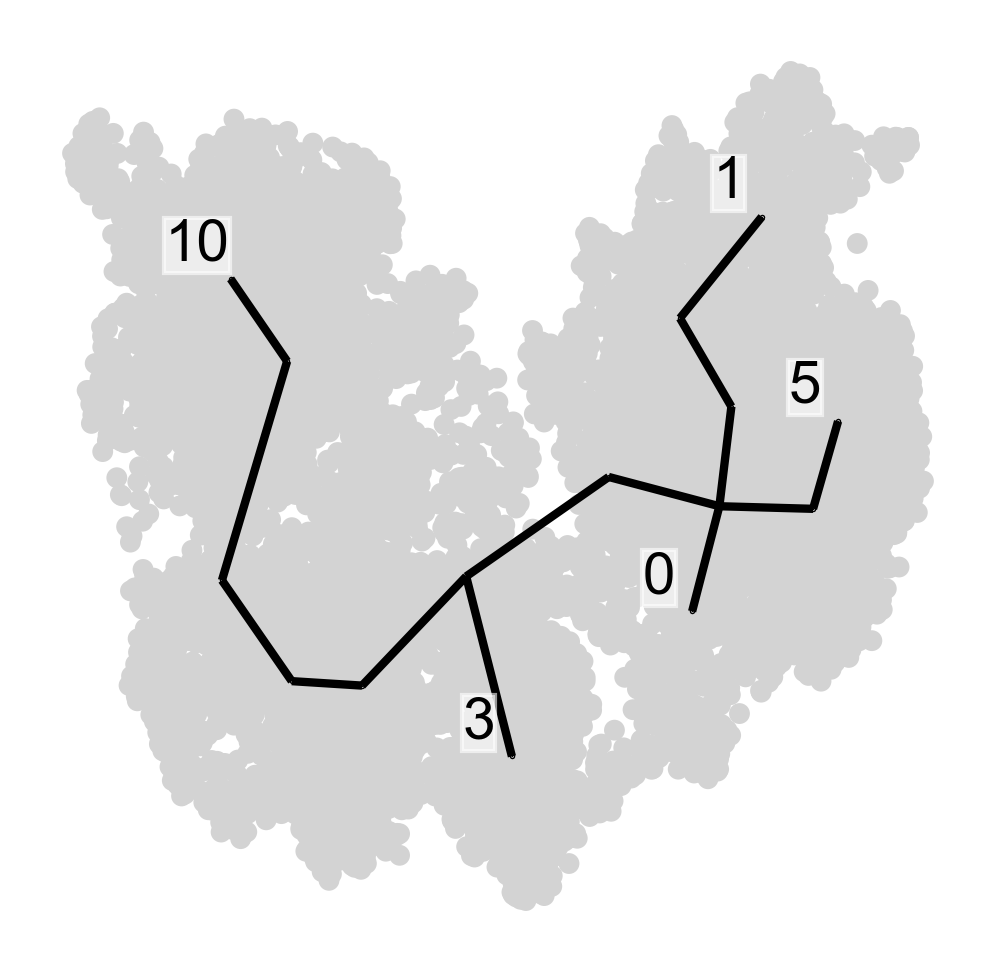

In [172]:
scf.pl.graph(adata_raw_scvi,basis="umap",size_nodes=.1,forks=False,s=100)

In [186]:
scf.tl.root(adata_raw_scvi,5)
scf.tl.pseudotime(adata_raw_scvi)

node 5 selected as a root --> added
    .uns['graph']['root'] selected root.
    .uns['graph']['pp_info'] for each PP, its distance vs root and segment assignment.
    .uns['graph']['pp_seg'] segments network information.
projecting cells onto the principal graph
    finished (0:00:06) --> added
    .obs['edge'] assigned edge.
    .obs['t'] pseudotime value.
    .obs['seg'] segment of the tree assigned.
    .obs['milestones'] milestone assigned.
    .uns['pseudotime_list'] list of cell projection from all mappings.


G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


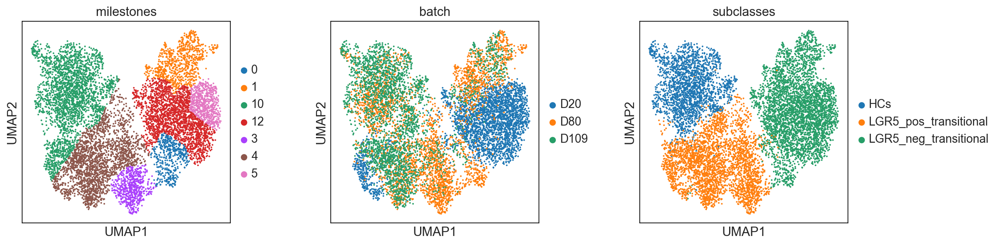

In [187]:
sc.set_figure_params(dpi_save=600)
sc.pl.umap(adata_raw_scvi,color=["milestones",'batch','subclasses'],wspace=0.35)

In [188]:
mils=pd.Series(adata_raw_scvi.uns["graph"]["milestones"])
adata_raw_scvi.uns["milestones_colors"]=np.array(adata_raw_scvi.uns["milestones_colors"])
adata_raw_scvi.uns["seg_colors"]=[adata_raw_scvi.uns["milestones_colors"][m][0] 
                         for m in [adata_raw_scvi.obs.milestones.cat.categories==mils[mils==t].index[0] 
                                   for t in adata_raw_scvi.uns["graph"]["pp_seg"].to]]

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


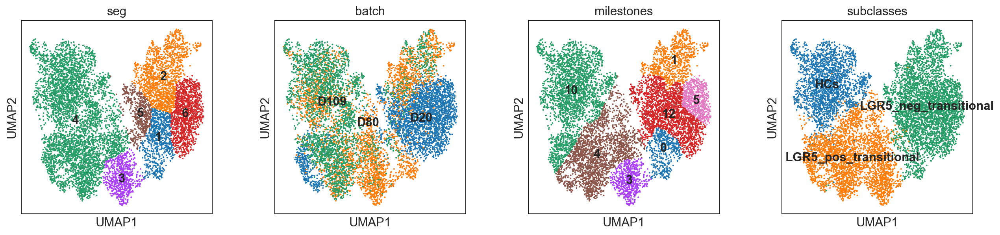

In [189]:
sc.pl.umap(adata_raw_scvi,color=["seg","batch","milestones",'subclasses'],legend_loc="on data")

G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


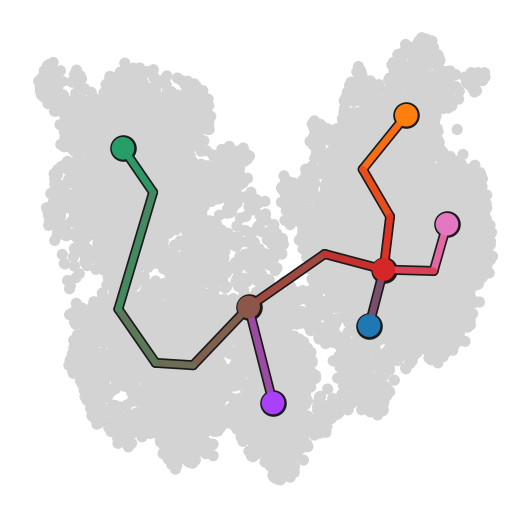

In [190]:
sc.set_figure_params(dpi_save=600)
scf.pl.trajectory(adata_raw_scvi,color_seg="milestones",basis="umap",frameon=False,s=100,scale_path=.6,save="paths2.png")

In [191]:
scf.tl.dendrogram(adata_raw_scvi,crowdedness=.2)

Generating dendrogram of tree
    segment : 100%|████████████████| 5/5 [00:10<00:00,  2.04s/it]
    finished (0:00:10) --> added 
    .obsm['X_dendro'], new embedding generated.
    .uns['dendro_segments'] tree segments used for plotting.


G:\Miniconda3\envs\scvi-env\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


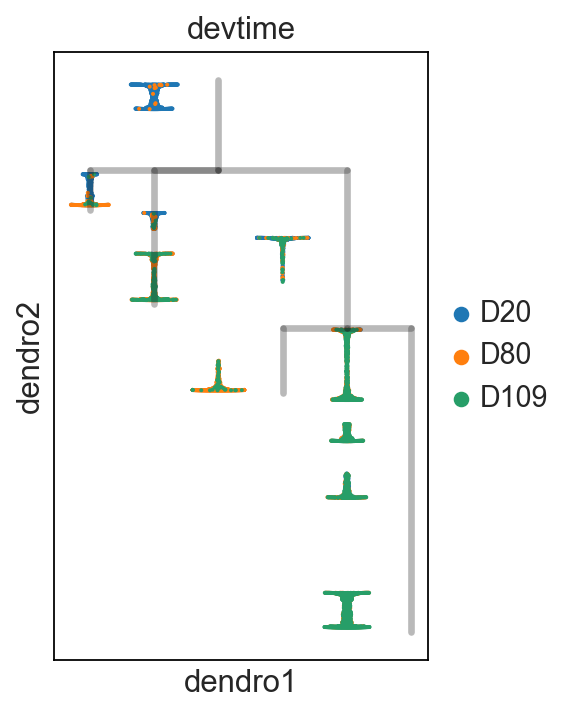

In [193]:
sc.set_figure_params(figsize=(3,5))
scf.pl.dendrogram(adata_raw_scvi,color="devtime")